<a href="https://colab.research.google.com/github/ken7184/project/blob/main/shap_lime.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!mkdir -p /content/gdrive
from google.colab import drive
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/survey.csv')

In [ ]:
data.drop(columns=['Timestamp', 'Country', 'state', 'comments'], inplace = True)

In [ ]:
data.rename({'self_employed' : 'Self_Employed', 'family_history' : 'Family_History',
           'treatment' : 'Treatment', 'work_interfere' : 'Work_Interfere',
           'no_employees': 'Employee_Count_Company', 'remote_work': 'Remote_Work', 'tech_company': 'Tech_Company',
           'benefits': 'Benefits', 'care_options': 'Care_Options', 'wellness_program': 'Wellness_Program',
           'seek_help': 'Seek_Help', 'anonymity': 'Anonymity', 'leave': 'Medical_Leave',
           'mental_health_consequence': 'Mental_Health_Consequence',
           'phys_health_consequence': 'Physical_Health_Consequence', 'coworkers': 'Coworkers_Reach',
           'supervisor': 'Supervisor_Reach', 'mental_health_interview': 'Mental_Health_Interview',
           'phys_health_interview': 'Physical_Health_Interview', 'mental_vs_physical': 'Mental_VS_Physical',
           'obs_consequence': 'Observed_Consequence_Workplace'} , inplace = True , axis = 1)

In [ ]:
median_age = data['Age'].median()

In [ ]:
data['Age'].replace([data['Age'][data['Age'] < 15]], median_age, inplace = True)
data['Age'].replace([data['Age'][data['Age'] > 100]], median_age, inplace = True)

In [ ]:
data['Gender'].replace(['Male ', 'male', 'M', 'm', 'Male', 'Cis Male',
                     'Man', 'cis male', 'Mail', 'Male-ish', 'Male (CIS)',
                      'Cis Man', 'msle', 'Malr', 'Mal', 'maile', 'Make',], 'Male', inplace = True)

data['Gender'].replace(['Female ', 'female', 'F', 'f', 'Woman', 'Female',
                     'femail', 'Cis Female', 'cis-female/femme', 'Femake', 'Female (cis)',
                     'woman',], 'Female', inplace = True)

data["Gender"].replace(['Female (trans)', 'queer/she/they', 'non-binary',
                     'fluid', 'queer', 'Androgyne', 'Trans-female', 'male leaning androgynous',
                      'Agender', 'A little about you', 'Nah', 'All',
                      'ostensibly male, unsure what that really means',
                      'Genderqueer', 'Enby', 'p', 'Neuter', 'something kinda male?',
                      'Guy (-ish) ^_^', 'Trans woman',], 'Others', inplace = True)

In [ ]:
data.isnull().sum()

Age                                 0
Gender                              0
Self_Employed                      18
Family_History                      0
Treatment                           0
Work_Interfere                    264
Employee_Count_Company              0
Remote_Work                         0
Tech_Company                        0
Benefits                            0
Care_Options                        0
Wellness_Program                    0
Seek_Help                           0
Anonymity                           0
Medical_Leave                       0
Mental_Health_Consequence           0
Physical_Health_Consequence         0
Coworkers_Reach                     0
Supervisor_Reach                    0
Mental_Health_Interview             0
Physical_Health_Interview           0
Mental_VS_Physical                  0
Observed_Consequence_Workplace      0
dtype: int64

In [ ]:
data['Treatment'] = np.where(data['Treatment'] == 'Yes', 1, 0)

In [ ]:
X = data.drop(["Treatment"], axis=1)
Y = data["Treatment"]


In [ ]:
X = pd.get_dummies(X, drop_first=True)

In [ ]:
X.shape

(1259, 44)

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.30, random_state=121)

# Logistic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
lr_clf = LogisticRegression(max_iter = 1000)
lr_clf.fit(X_train, y_train)
lr_preds = lr_clf.predict(X_test)
lr_pre = precision_score(y_test, lr_preds)
lr_rec = recall_score(y_test, lr_preds)
lr_f1 = f1_score(y_test, lr_preds)
lr_acc = accuracy_score(y_test, lr_preds)
[lr_pre, lr_rec, lr_f1, lr_acc]

[0.827906976744186, 0.8944723618090452, 0.8599033816425119, 0.8465608465608465]

In [ ]:
%pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 532.9/532.9 kB 8.2 MB/s eta 0:00:00


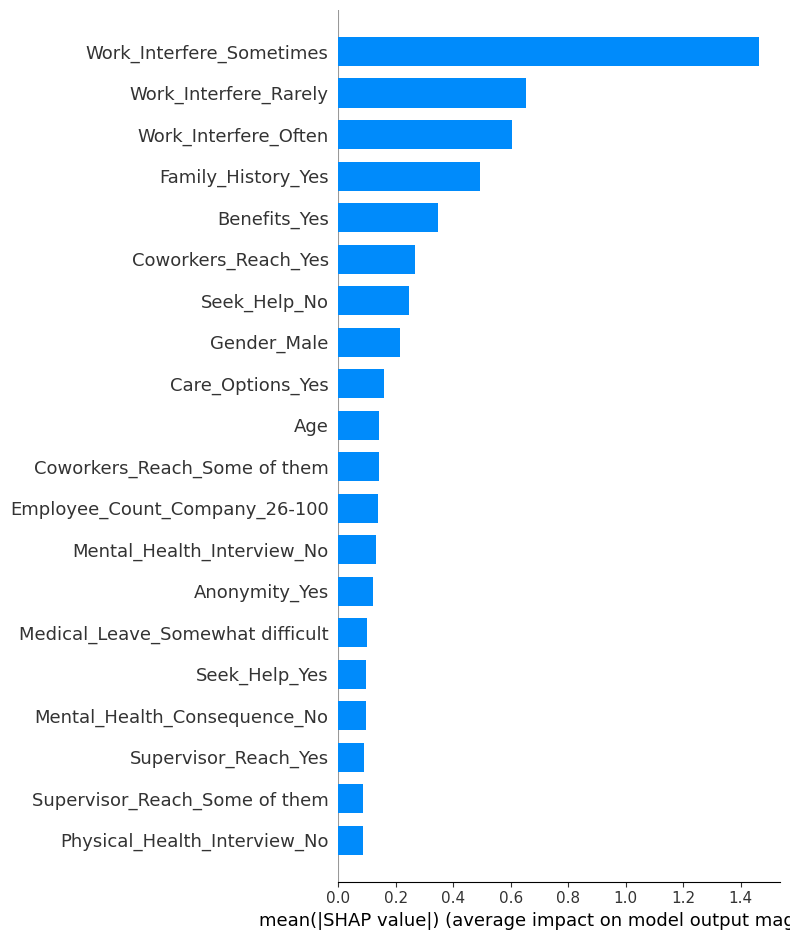

In [ ]:
# Shap
import shap
import matplotlib.pyplot as plt

# Assuming lr_clf is your logistic regression model
explainer = shap.Explainer(lr_clf, X_train)
shap_values = explainer.shap_values(X_test)

# Summary plot using the 'bar' plot_type
shap.summary_plot(shap_values, X_test, class_names=lr_clf.classes_, plot_type='bar')

In [ ]:
%pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=85b3d0b6ac8126f3924e29535d48afd24b40579729194c62de09711e69205e99
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
import lime
import lime.lime_tabular
from sklearn.pipeline import make_pipeline

explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

lr_pipeline = make_pipeline(lr_clf)

explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         lr_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()


X does not have valid feature names, but LogisticRegression was fitted with feature names


KNN

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV

knn_m = KNeighborsClassifier()
param_grid = {'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]}
grid_search = GridSearchCV(knn_m, param_grid, scoring='accuracy', cv=5)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_
knn_m = KNeighborsClassifier(n_neighbors=best_params['n_neighbors'])

knn_m.fit(X_train, y_train)
knn_preds = knn_m.predict(X_test)
knn_pre = precision_score(y_test, knn_preds)
knn_rec = recall_score(y_test, knn_preds)
knn_f1 = f1_score(y_test, knn_preds)
knn_acc = accuracy_score(y_test, knn_preds)
[knn_pre, knn_rec, knn_f1, knn_acc]
# Applying Gridsearch to find best n_neighbor

[0.7428571428571429,
 0.5226130653266332,
 0.6135693215339233,
 0.6534391534391535]

PermutationExplainer explainer: 379it [10:38,  1.70s/it]


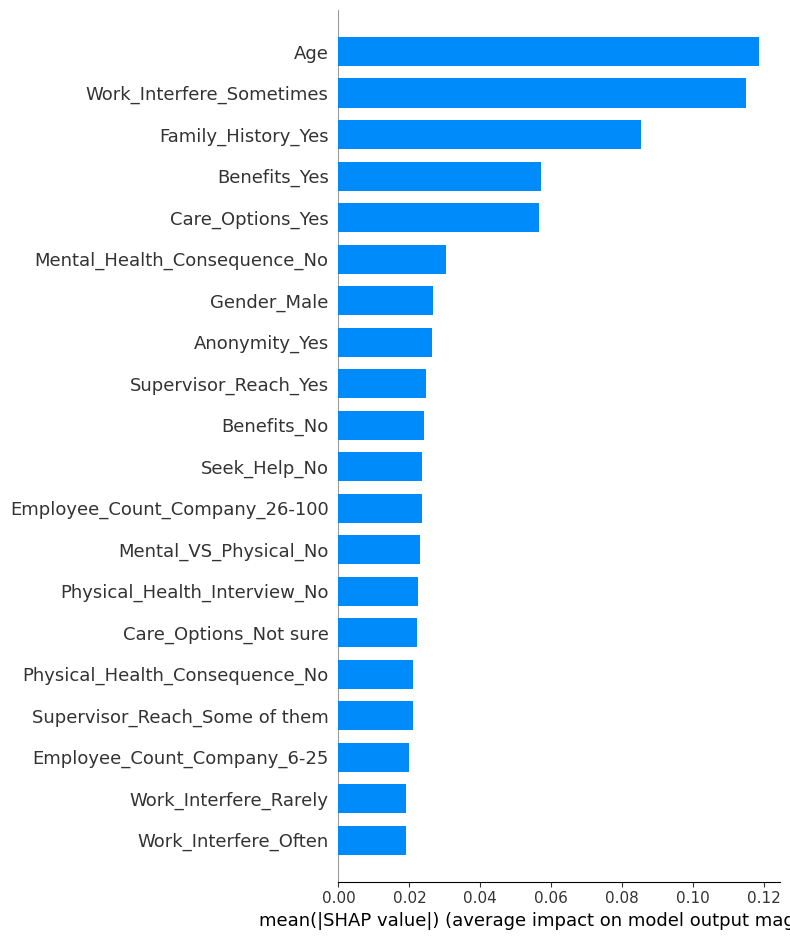

In [ ]:
# Shap
explainer = shap.Explainer(knn_m.predict, X_train)
shap_values = explainer(X_test)
shap.summary_plot(shap_values, X_test, plot_type='bar')

In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

lr_pipeline = make_pipeline(knn_m)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         lr_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()


X does not have valid feature names, but KNeighborsClassifier was fitted with feature names


Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree


dt_clf = DecisionTreeClassifier(criterion="gini", max_depth=4, random_state=1)
dt_clf.fit(X_train, y_train)
dt_preds = dt_clf.predict(X_test)
dt_pre = precision_score(y_test, dt_preds)
dt_rec = recall_score(y_test, dt_preds)
dt_f1 = f1_score(y_test, dt_preds)
dt_acc = accuracy_score(y_test, dt_preds)
[dt_pre, dt_rec, dt_f1, dt_acc]

[0.7949790794979079,
 0.9547738693467337,
 0.8675799086757991,
 0.8465608465608465]

[Text(0.5, 0.9, 'x[4] <= 0.5\ngini = 0.5\nsamples = 881\nvalue = [443, 438]'),
 Text(0.25, 0.7, 'x[7] <= 0.5\ngini = 0.45\nsamples = 533\nvalue = [351, 182]'),
 Text(0.125, 0.5, 'x[5] <= 0.5\ngini = 0.349\nsamples = 390\nvalue = [302, 88]'),
 Text(0.0625, 0.3, 'x[6] <= 0.5\ngini = 0.262\nsamples = 348\nvalue = [294, 54]'),
 Text(0.03125, 0.1, 'gini = 0.096\nsamples = 276\nvalue = [262, 14]'),
 Text(0.09375, 0.1, 'gini = 0.494\nsamples = 72\nvalue = [32, 40]'),
 Text(0.1875, 0.3, 'x[16] <= 0.5\ngini = 0.308\nsamples = 42\nvalue = [8, 34]'),
 Text(0.15625, 0.1, 'gini = 0.408\nsamples = 28\nvalue = [8, 20]'),
 Text(0.21875, 0.1, 'gini = 0.0\nsamples = 14\nvalue = [0, 14]'),
 Text(0.375, 0.5, 'x[16] <= 0.5\ngini = 0.45\nsamples = 143\nvalue = [49, 94]'),
 Text(0.3125, 0.3, 'x[0] <= 40.5\ngini = 0.482\nsamples = 101\nvalue = [41, 60]'),
 Text(0.28125, 0.1, 'gini = 0.496\nsamples = 86\nvalue = [39, 47]'),
 Text(0.34375, 0.1, 'gini = 0.231\nsamples = 15\nvalue = [2, 13]'),
 Text(0.4375, 0.3, 

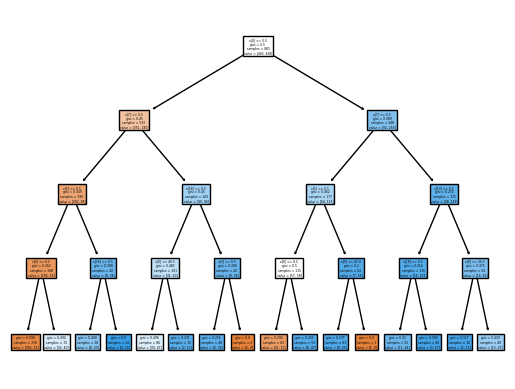

In [ ]:
plot_tree(dt_clf, filled=True)

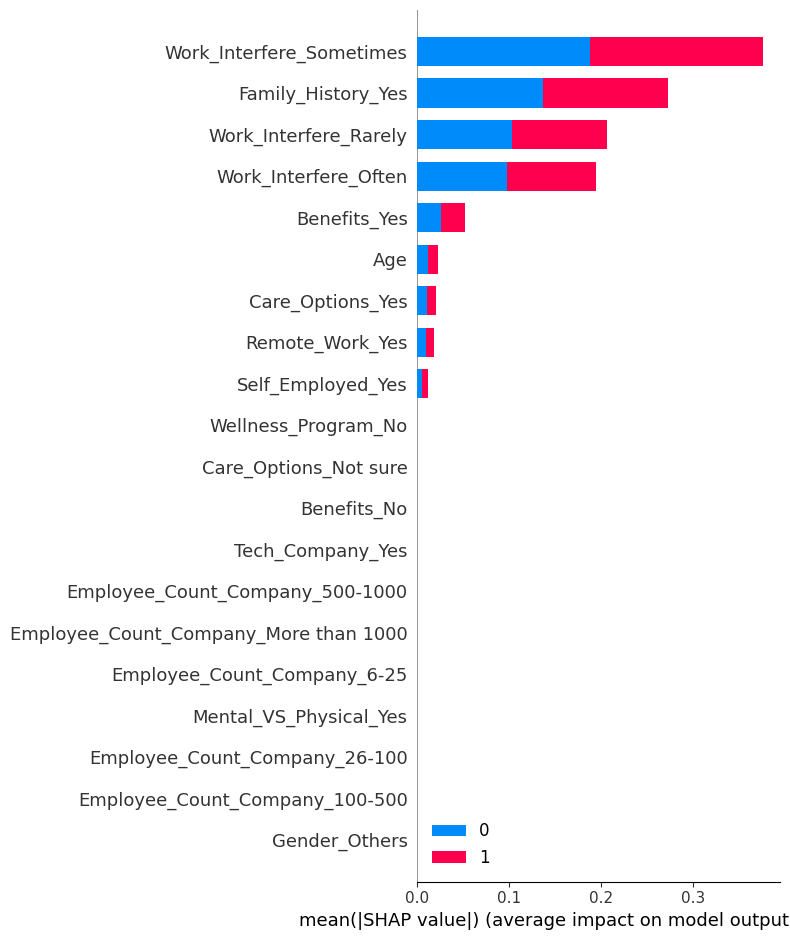

In [ ]:
# Shap

explainer = shap.TreeExplainer(dt_clf)

shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=dt_clf.classes_)

In [ ]:
pd.DataFrame(dt_clf.feature_importances_, columns=["Imp"], index=X_train.columns).sort_values(by="Imp", ascending=False)

,Imp
Family_History_Yes,0.286507
Work_Interfere_Rarely,0.253404
Work_Interfere_Sometimes,0.200613
Work_Interfere_Often,0.192236
Age,0.025369
Benefits_Yes,0.018735
Self_Employed_Yes,0.012054
Care_Options_Yes,0.005655
Remote_Work_Yes,0.005426
Physical_Health_Interview_Yes,0.000000


In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

dt_pipeline = make_pipeline(dt_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         dt_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(n_estimators = 200, max_depth= 12, min_samples_leaf = 6, min_samples_split = 20, random_state = 121)
rf_clf.fit(X_train, y_train)
rf_preds = rf_clf.predict(X_test)
rf_pre = precision_score(y_test, rf_preds)
rf_rec = recall_score(y_test, rf_preds)
rf_f1 = f1_score(y_test, rf_preds)
rf_acc = accuracy_score(y_test, rf_preds)
[rf_pre, rf_rec, rf_f1, rf_acc]

[0.7857142857142857,
 0.8844221105527639,
 0.8321513002364066,
 0.8121693121693122]

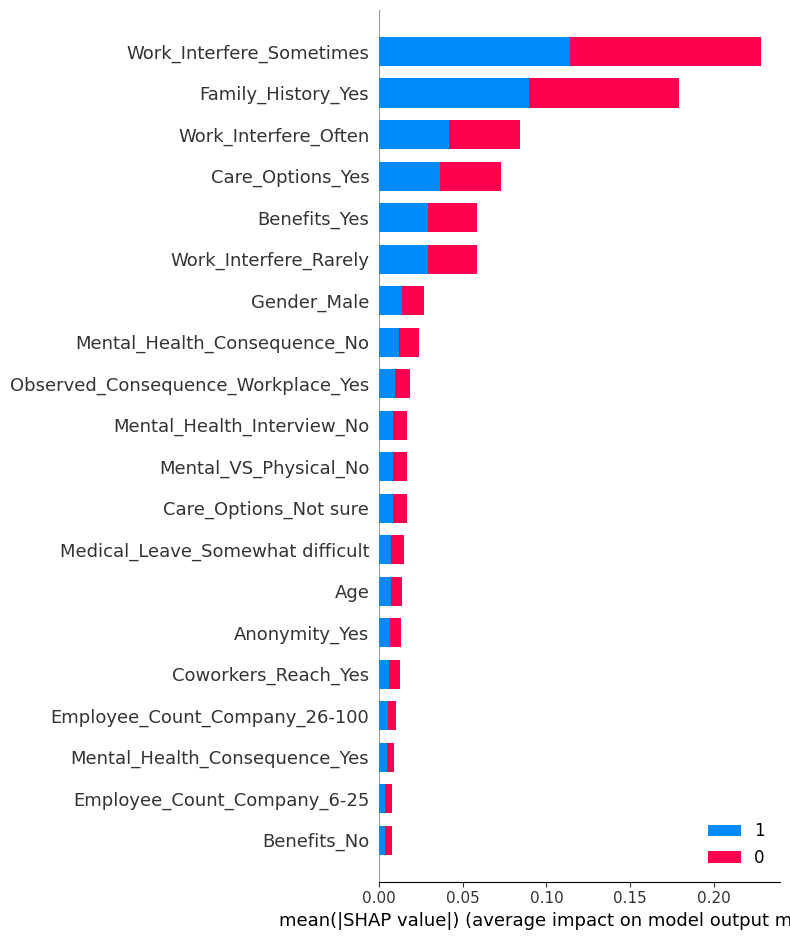

In [ ]:
# Shap
import shap
import matplotlib.pyplot as plt

explainer = shap.TreeExplainer(rf_clf)

shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=rf_clf.classes_)



In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

rf_pipeline = make_pipeline(rf_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         rf_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but RandomForestClassifier was fitted with feature names


In [ ]:
# Gradient Booster
from sklearn.ensemble import GradientBoostingClassifier
gb_clf = GradientBoostingClassifier(n_estimators=50, learning_rate=1.0,max_depth=1, random_state=121)
gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_test)
gb_pre = precision_score(y_test, gb_preds)
gb_rec = recall_score(y_test, gb_preds)
gb_f1 = f1_score(y_test, gb_preds)
gb_acc = accuracy_score(y_test, gb_preds)
[gb_pre, gb_rec, gb_f1, gb_acc]


[0.8364485981308412,
 0.8994974874371859,
 0.8668280871670702,
 0.8544973544973545]

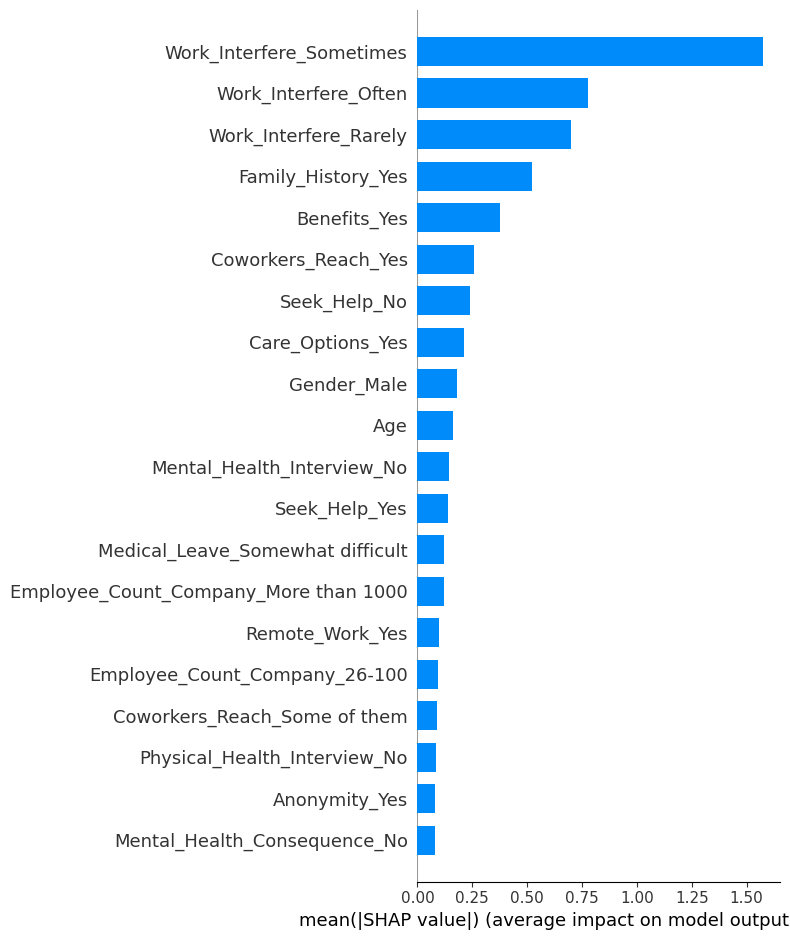

In [ ]:
# Shap
explainer = shap.TreeExplainer(gb_clf)
shap_values = explainer(X_test)

shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=gb_preds, plot_type='bar')

In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

gb_pipeline = make_pipeline(gb_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         gb_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names


In [ ]:
# Ada Boost

from sklearn.ensemble import AdaBoostClassifier
ada_clf = AdaBoostClassifier(n_estimators=50, random_state=121)
ada_clf.fit(X_train, y_train)
ada_preds = ada_clf.predict(X_test)
ada_pre = precision_score(y_test, ada_preds)
ada_rec = recall_score(y_test, ada_preds)
ada_f1 = f1_score(y_test, ada_preds)
ada_acc = accuracy_score(y_test, ada_preds)
[ada_pre, ada_rec, ada_f1, ada_acc]


[0.8349056603773585,
 0.8894472361809045,
 0.8613138686131387,
 0.8492063492063492]

PermutationExplainer explainer: 379it [01:43,  3.29it/s]


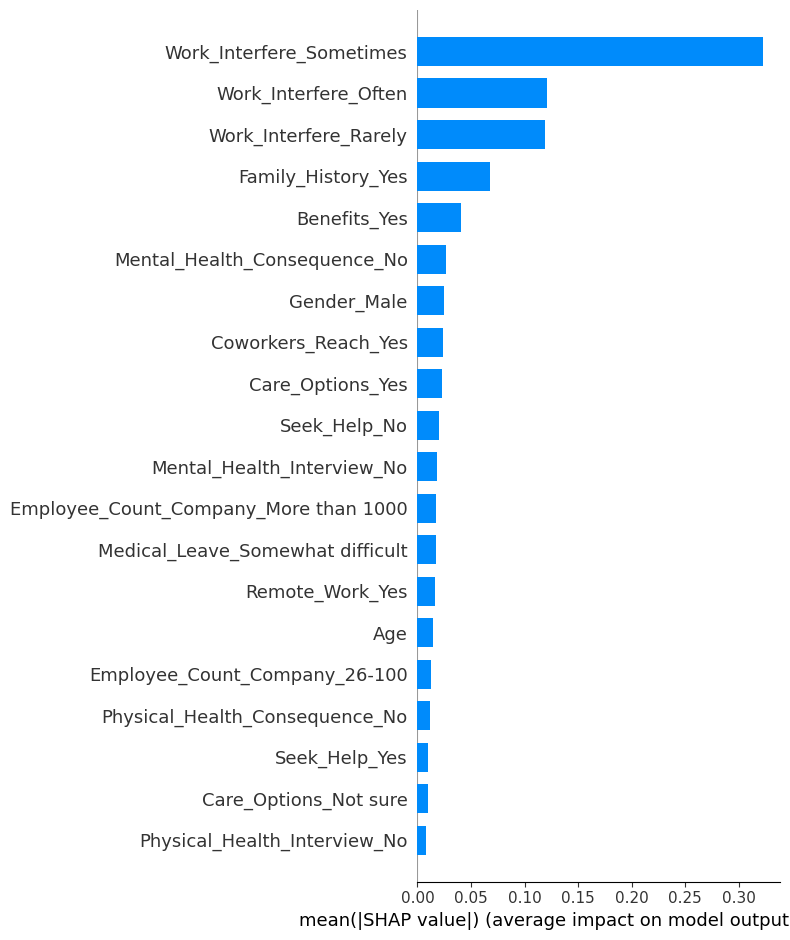

In [ ]:
# Shap
import shap
explainer = shap.Explainer(ada_clf.predict, X_train)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=ada_clf.classes_, plot_type='bar')

plt.show()


In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

ada_pipeline = make_pipeline(ada_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         ada_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but AdaBoostClassifier was fitted with feature names


In [ ]:
# SGD

from sklearn.linear_model import SGDClassifier
sgd_clf = SGDClassifier(max_iter=1000, loss = 'log_loss', tol=1e-3)
sgd_clf.fit(X_train, y_train)
sgd_preds = sgd_clf.predict(X_test)
sgd_pre = precision_score(y_test, sgd_preds)
sgd_rec = recall_score(y_test, sgd_preds)
sgd_f1 = f1_score(y_test, sgd_preds)
sgd_acc = accuracy_score(y_test, sgd_preds)
[sgd_pre, sgd_rec, sgd_f1, sgd_acc]

[0.9206349206349206,
 0.2914572864321608,
 0.4427480916030534,
 0.6137566137566137]

  0%|          | 0/378 [00:00<?, ?it/s]

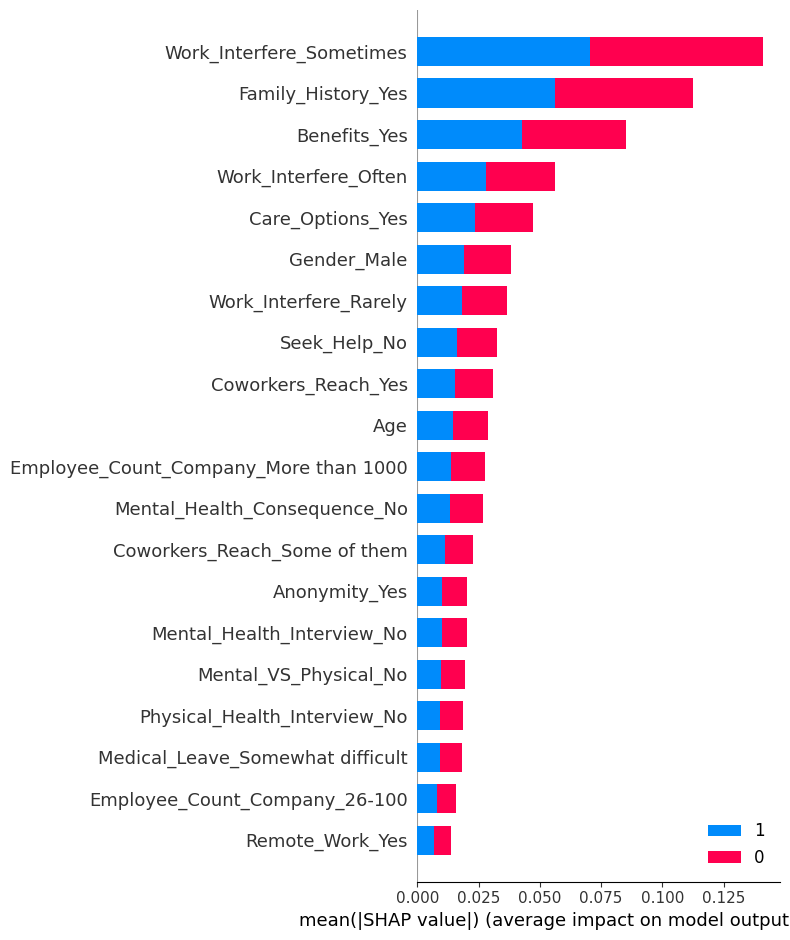

In [ ]:
import shap
import pandas as pd
import matplotlib.pyplot as plt

explainer = shap.KernelExplainer(sgd_clf.predict_proba, shap.kmeans(X_test, 20))
shap_values = explainer.shap_values(X_test)

# Summary plot using the 'bar' plot_type
shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=sgd_clf.classes_, plot_type='bar')

plt.show()




In [ ]:
# Lime work - change to log loss
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

sgd_pipeline = make_pipeline(sgd_clf)


explanation = explainer.explain_instance(X_test.iloc[1].values,
                                         sgd_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but SGDClassifier was fitted with feature names


In [ ]:
# Naive Bayes
from sklearn.naive_bayes import GaussianNB
nb_clf = GaussianNB()
nb_clf.fit(X_train, y_train)
nb_preds = nb_clf.predict(X_test)
nb_pre = precision_score(y_test, nb_preds)
nb_rec = recall_score(y_test, nb_preds)
nb_f1 = f1_score(y_test, nb_preds)
nb_acc = accuracy_score(y_test, nb_preds)
[nb_pre, nb_rec, nb_f1, nb_acc]

[0.7483443708609272, 0.5678391959798995, 0.6457142857142857, 0.671957671957672]

PermutationExplainer explainer: 379it [00:13,  6.61it/s]                         


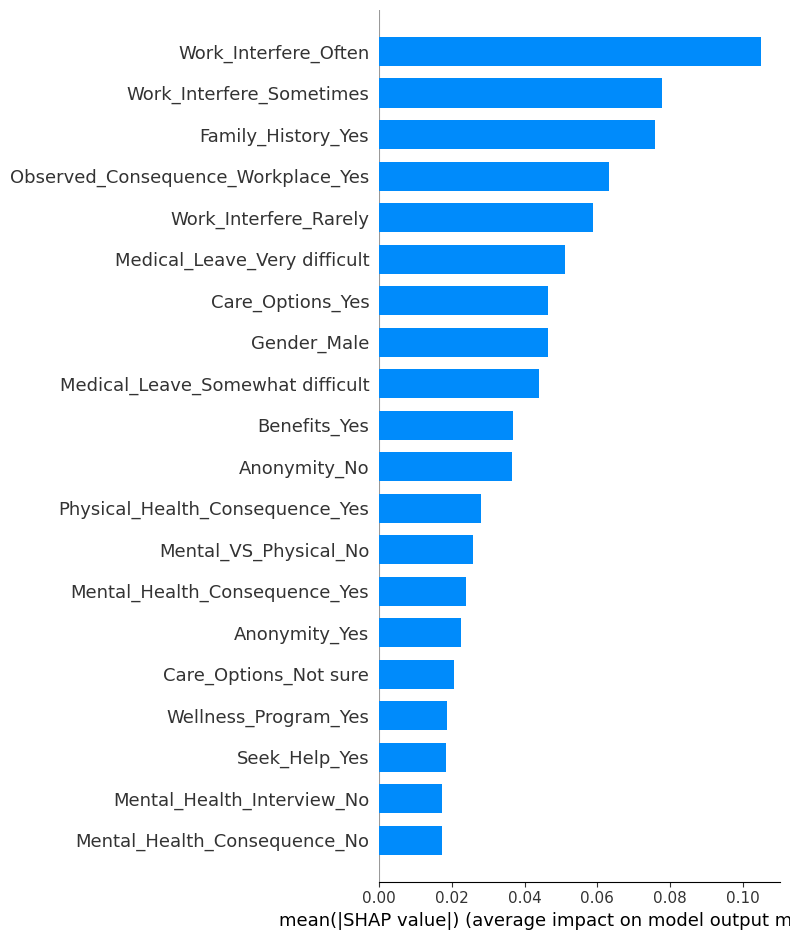

In [ ]:
# Shap work
explainer = shap.Explainer(nb_clf.predict, X_train)
shap_values = explainer(X_test)

shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=nb_preds, plot_type='bar')

In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

nb_pipeline = make_pipeline(nb_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         nb_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but GaussianNB was fitted with feature names


In [ ]:
# SVM

from sklearn import svm
svm_clf = svm.SVC(kernel = "linear", probability=True)
svm_clf.fit(X_train, y_train)
svm_preds = svm_clf.predict(X_test)
svm_pre = precision_score(y_test, svm_preds)
svm_rec = recall_score(y_test, svm_preds)
svm_f1 = f1_score(y_test, svm_preds)
svm_acc = accuracy_score(y_test, svm_preds)
[svm_pre, svm_rec, svm_f1, svm_acc]


[0.7949790794979079,
 0.9547738693467337,
 0.8675799086757991,
 0.8465608465608465]

PermutationExplainer explainer: 379it [02:46,  2.12it/s]


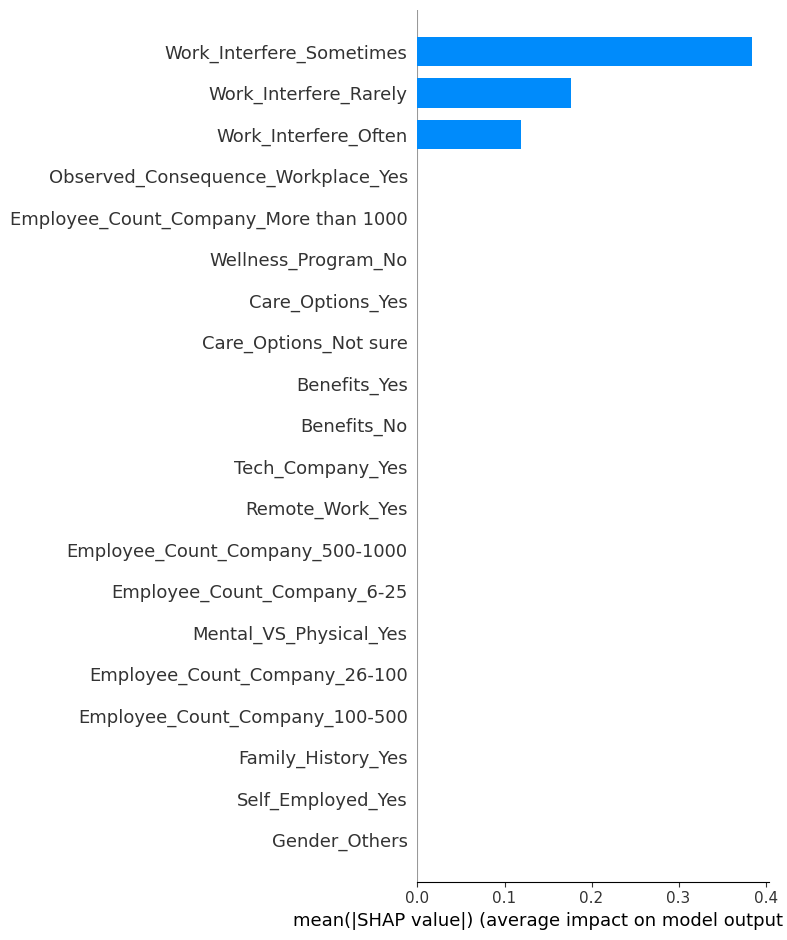

In [ ]:
explainer = shap.Explainer(svm_clf.predict, X_train)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=svm_preds, plot_type = 'bar')

In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

svm_pipeline = make_pipeline(svm_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         svm_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

X does not have valid feature names, but SVC was fitted with feature names


In [ ]:
# XG Boost

from xgboost import XGBClassifier
xgb_clf = XGBClassifier()
xgb_clf.fit(X_train, y_train)
xgb_preds = xgb_clf.predict(X_test)
xgb_pre = precision_score(y_test, xgb_preds)
xgb_rec = recall_score(y_test, xgb_preds)
xgb_f1 = f1_score(y_test, xgb_preds)
xgb_acc = accuracy_score(y_test, xgb_preds)
[xgb_pre, xgb_rec, xgb_f1, xgb_acc]

[0.8146341463414634,
 0.8391959798994975,
 0.8267326732673267,
 0.8148148148148148]

[05:59:13] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


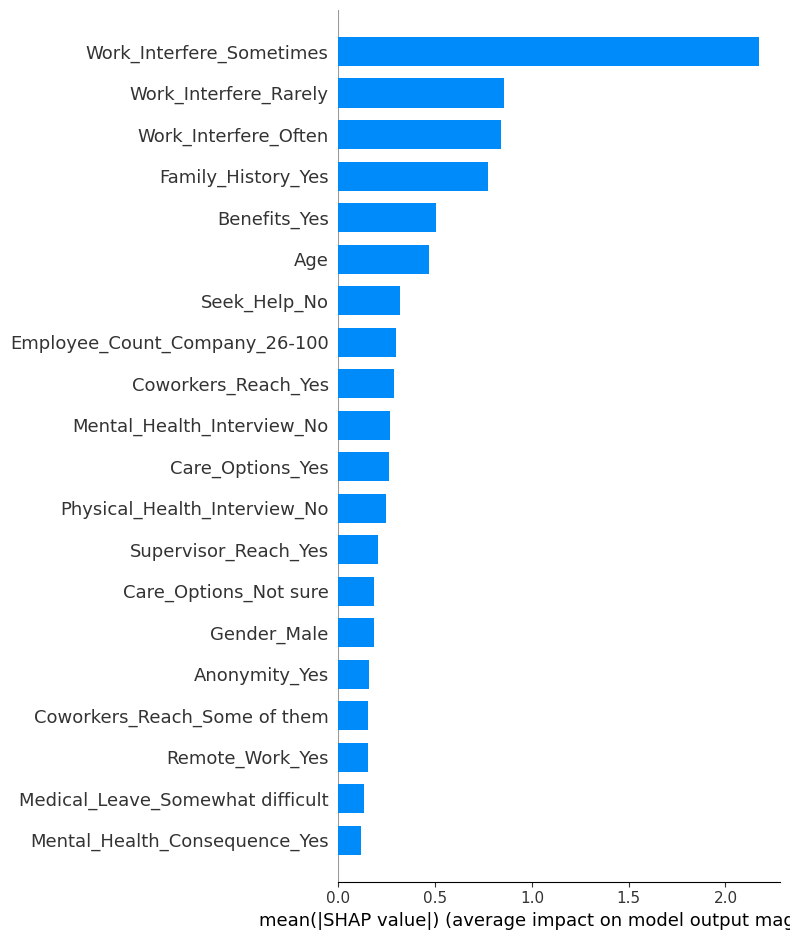

In [ ]:
# shap
explainer = shap.TreeExplainer(xgb_clf, X_train)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=xgb_clf.classes_, plot_type='bar')

In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

xgb_pipeline = make_pipeline(xgb_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         xgb_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()

In [ ]:
# light gbm
%pip install lightgbm

In [ ]:
import lightgbm as lgb
lgb_clf = lgb.LGBMClassifier(num_round = 10)
lgb_clf.fit(X_train, y_train)
lgb_preds = lgb_clf.predict(X_test)
lgb_pre = precision_score(y_test, lgb_preds)
lgb_rec = recall_score(y_test, lgb_preds)
lgb_f1 = f1_score(y_test, lgb_preds)
lgb_acc = accuracy_score(y_test, lgb_preds)
[lgb_pre, lgb_rec, lgb_f1, lgb_acc]


[LightGBM] [Warning] num_iterations is set=10, num_round=10 will be ignored. Current value: num_iterations=10
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 438, number of negative: 443
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000550 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 123
[LightGBM] [Info] Number of data points in the train set: 881, number of used features: 43
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.497162 -> initscore=-0.011351
[LightGBM] [Info] Start training from score -0.011351


Found `num_round` in params. Will use it instead of argument


[0.8240740740740741, 0.8944723618090452, 0.8578313253012048, 0.843915343915344]

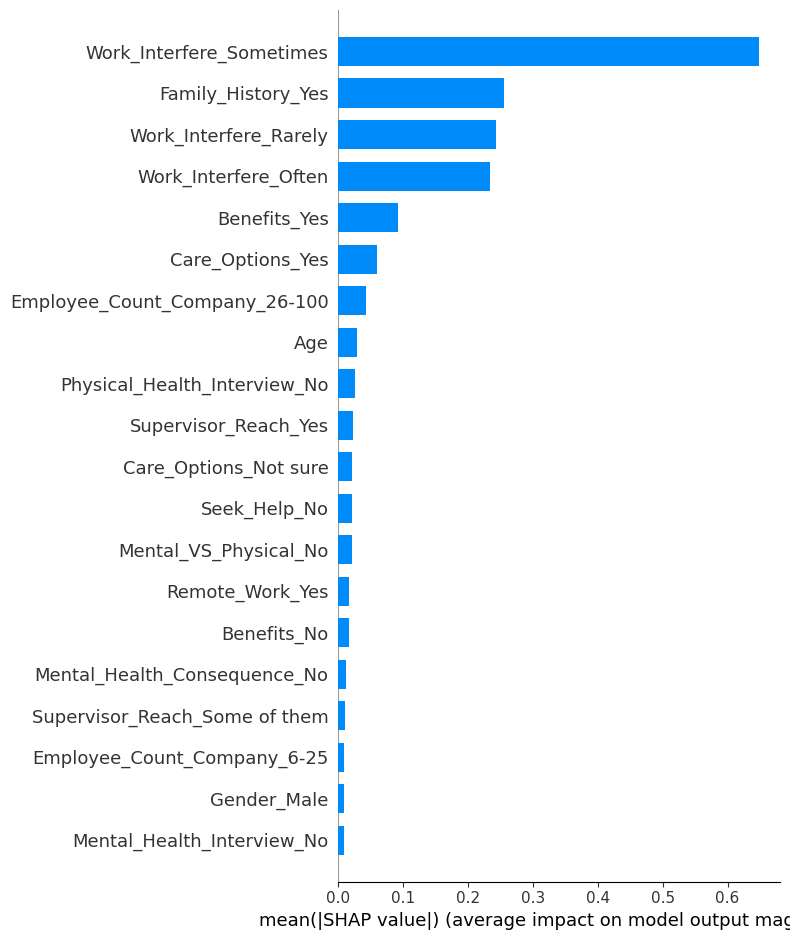

In [ ]:
# Shap
explainer = shap.TreeExplainer(lgb_clf, X_train)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, features=X_test, feature_names=X_test.columns, class_names=lgb_clf.classes_, plot_type='bar')

In [ ]:
# Lime
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                  mode="classification",
                                                  training_labels=y_train,
                                                  feature_names=X_train.columns.tolist())

lgb_pipeline = make_pipeline(lgb_clf)


explanation = explainer.explain_instance(X_test.iloc[0].values,
                                         lgb_pipeline.predict_proba,
                                         num_features=len(X_test.columns))

explanation.show_in_notebook()